# LOADING OF DATA

First we have to import some libraries to load the dataset and to handle another functions like cleaning of data,plotting of data,define relation between the columns through correlation and visualisation etc.

In [91]:
# to handle datasets
import pandas as pd
import numpy as np

# for plotting
import matplotlib.pyplot as plt
import seaborn as sns

# for the yeo-johnson transformation
import scipy.stats as stats

#Never display warnings when match
import warnings
warnings.filterwarnings('ignore')

# to display all the columns of the dataframe in the notebook
pd.pandas.set_option('display.max_columns', None)
pd.pandas.set_option('display.max_rows', None)

In [92]:
#load of data
df = pd.read_excel('innercity.xlsx')        # this is for excel file
#df = pd.read_csv('data.csv')               # this is for csv file

In [93]:
#shape/dimentions of data
# it shows the total number of rows and columns in a dataset.
df.shape

(21613, 23)

In [94]:
# to showing first five rows we use head and for last 5 rows we use tail.
df.head()
df.tail()

,cid,dayhours,price,room_bed,room_bath,living_measure,lot_measure,ceil,coast,sight,condition,quality,ceil_measure,basement,yr_built,yr_renovated,zipcode,lat,long,living_measure15,lot_measure15,furnished,total_area
21608,203600600,20150310T000000,685530,4.0,2.50,3130.0,60467.0,2,0,0.0,3,9.0,3130.0,0.0,1996,0,98014,47.6618,-121.962,2780.0,44224.0,1.0,63597
21609,625049281,20140521T000000,535000,2.0,1.00,1030.0,4841.0,1,0,0.0,3,7.0,920.0,110.0,1939,0,98103,47.6860,-122.341,1530.0,4944.0,0.0,5871
21610,424069018,20140905T000000,998000,3.0,3.75,3710.0,34412.0,2,0,0.0,3,10.0,2910.0,800.0,1978,0,98075,47.5888,-122.04,2390.0,34412.0,1.0,38122
21611,7258200055,20150206T000000,262000,4.0,2.50,1560.0,7800.0,2,0,0.0,3,7.0,1560.0,0.0,1997,0,98168,47.5140,-122.316,1160.0,7800.0,0.0,9360
21612,8805900430,20141229T000000,1150000,4.0,2.50,1940.0,4875.0,2,0,0.0,4,9.0,1940.0,0.0,1925,0,98112,47.6427,-122.304,1790.0,4875.0,1.0,6815


In [78]:
# we use info to know the type of the columns
df.info()
# we use describe for showing mean,standard deviation,minimum,maximum,25%,50% of dataset or the summary of numerical variables.
df.describe()
# if we want the describe data into different form(changing rows into columns or vice versa),we use Transpose.
df.describe().T

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 23 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   cid               21613 non-null  int64  
 1   dayhours          21613 non-null  object 
 2   price             21613 non-null  int64  
 3   room_bed          21505 non-null  float64
 4   room_bath         21505 non-null  float64
 5   living_measure    21596 non-null  float64
 6   lot_measure       21571 non-null  float64
 7   ceil              21571 non-null  object 
 8   coast             21612 non-null  object 
 9   sight             21556 non-null  float64
 10  condition         21556 non-null  object 
 11  quality           21612 non-null  float64
 12  ceil_measure      21612 non-null  float64
 13  basement          21612 non-null  float64
 14  yr_built          21612 non-null  object 
 15  yr_renovated      21613 non-null  int64  
 16  zipcode           21613 non-null  int64 

,count,mean,std,min,25%,50%,75%,max
cid,21613.0,4.580302e+09,2.876566e+09,1.000102e+06,2.123049e+09,3.904930e+09,7.308900e+09,9.900000e+09
price,21613.0,5.401822e+05,3.673622e+05,7.500000e+04,3.219500e+05,4.500000e+05,6.450000e+05,7.700000e+06
room_bed,21505.0,3.371355e+00,9.302886e-01,0.000000e+00,3.000000e+00,3.000000e+00,4.000000e+00,3.300000e+01
room_bath,21505.0,2.115171e+00,7.702481e-01,0.000000e+00,1.750000e+00,2.250000e+00,2.500000e+00,8.000000e+00
living_measure,21596.0,2.079861e+03,9.184961e+02,2.900000e+02,1.429250e+03,1.910000e+03,2.550000e+03,1.354000e+04
lot_measure,21571.0,1.510458e+04,4.142362e+04,5.200000e+02,5.040000e+03,7.618000e+03,1.068450e+04,1.651359e+06
sight,21556.0,2.343663e-01,7.664376e-01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,4.000000e+00
quality,21612.0,7.656857e+00,1.175484e+00,1.000000e+00,7.000000e+00,7.000000e+00,8.000000e+00,1.300000e+01
ceil_measure,21612.0,1.788367e+03,8.281025e+02,2.900000e+02,1.190000e+03,1.560000e+03,2.210000e+03,9.410000e+03
basement,21612.0,2.915225e+02,4.425808e+02,0.000000e+00,0.000000e+00,0.000000e+00,5.600000e+02,4.820000e+03


In [79]:
# for seeing the duplicates 
df.nunique()

cid                 21436
dayhours              372
price                3625
room_bed               13
room_bath              30
living_measure       1038
lot_measure          9765
ceil                    7
coast                   3
sight                   5
condition               6
quality                12
ceil_measure          946
basement              306
yr_built              117
yr_renovated           70
zipcode                70
lat                  5034
long                  753
living_measure15      774
lot_measure15        8682
furnished               2
total_area          11145
dtype: int64

# MISSING VALUES ANALYSIS

Now we will find the missing values in each column so that we can impute the values or delete the rows or column and whatever treatment we have to do.

In [ ]:
# it shows true on the place where the value is missing otherwise shows false.
df.isnull()

<AxesSubplot:>

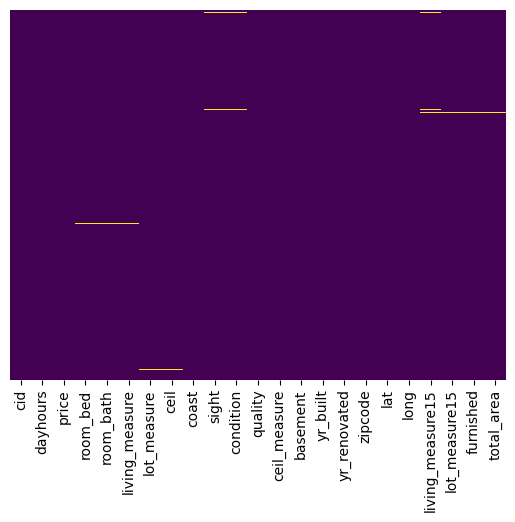

In [8]:
# it shows null values in form of a graph
sns.heatmap(df.isnull(),yticklabels=False,cbar=False,cmap='viridis')

# CODE TO FIND NULL VALUES


In [80]:
# it shows missing values in decimal for each column.
df.isnull().mean()
# it shows missing values in %
df.isnull().mean()*100
# it shows missing values in ascending or descending order.
#df.

cid                 0.000000
dayhours            0.000000
price               0.000000
room_bed            0.499699
room_bath           0.499699
living_measure      0.078656
lot_measure         0.194327
ceil                0.194327
coast               0.004627
sight               0.263730
condition           0.263730
quality             0.004627
ceil_measure        0.004627
basement            0.004627
yr_built            0.004627
yr_renovated        0.000000
zipcode             0.000000
lat                 0.000000
long                0.000000
living_measure15    0.768056
lot_measure15       0.134179
furnished           0.134179
total_area          0.134179
dtype: float64

# CODE TO DELETE COLUMN

In [82]:
# if more than 30% of values are missing, so we can detele that column.
# If we have very less data missing in rows then we will delete that rows.
df.drop("col.name", axis = 1, inplace = True)
# Multiple features to drop
df.drop(['column1','column2','column3'],axis=1,inplace=True)
# to delete all null values
df.dropna()
# to delete all null values in row or column
df['column name'].dropna()

In [95]:
df=df.dropna()

REPLACING FUNCTION

In [96]:
df =df.replace("$",np.nan)

# CODE TO IMPUTE VALUES

In [ ]:
# if less than 30% of values are missing,so we can impute in that column,otherwise delete or drop that column or row.

There are some methods to imputing the data:                                                                                    

In [ ]:
#  1. If we want to impute values by ourself,then  (fill null values)
df1 = df.fillna(value=0)      # 0 is the value i want to fill ,we can choose any random value

In [ ]:
# 2. if we want to impute the previous value in every row or column
df1 = df.fillna(method="Pad")

In [ ]:
# 3. if we want to fill the next value in every row and column
df1 = df.fillna(method="bfill")

In [ ]:
# 4. if we want to fill different values in different columns then we can make a dictionary
df1 = df.fillna({"column name":value,"column name":value})

In [ ]:
# 5. Mean imputation 
# it always comes in numerical values
# column must make bell curve
# if our column has values like abc,or string value then we can't use mean method
df1 = df.fillna(value=df['living_measure'].mean())  # living measure is that column in which we want to fill mean value.

In [ ]:
# 6. Median imputation
# data has to be skewed (left skewed or right skewed)
# the variables must be numerical
df1 = df.fillna(value=df['living_measure'].median())

In [ ]:
# 7. Mode imputation
# the variable must be categorical
# the most the value used in the column it is mode
df1 = df.fillna(value=df['living_measure'].mode())

# EXPLORATORY DATA ANALYSIS (EDA)

1.EDA is applied to investigate the data and summarize the key insights.



2.It will give you the basic understanding of your data, it’s distribution, null values and much more.

3.You can either explore data using graphs or through some python functions.

4.There will be two type of analysis. Univariate and Bivariate. In the univariate, you will be analyzing a single attribute.

5.But in the bivariate, you will be analyzing an attribute with the target attribute.

6.In the non-graphical approach, you will be using functions such as shape, summary, describe, isnull, info, datatypes and more.

7.In the graphical approach, you will be using plots such as scatter, box, bar, density and correlation plots.

EDA is for seeing what the data can tell us beyond the formal modeling or hypothesis testing task.



# Before we do EDA, lets separate Numerical and categorical variables for easy analysis

In [101]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21387 entries, 0 to 21612
Data columns (total 23 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   cid               21387 non-null  int64  
 1   dayhours          21387 non-null  object 
 2   price             21387 non-null  int64  
 3   room_bed          21387 non-null  int64  
 4   room_bath         21387 non-null  int64  
 5   living_measure    21387 non-null  float64
 6   lot_measure       21387 non-null  float64
 7   ceil              21387 non-null  int64  
 8   coast             21387 non-null  int64  
 9   sight             21387 non-null  int64  
 10  condition         21387 non-null  int64  
 11  quality           21387 non-null  int64  
 12  ceil_measure      21387 non-null  float64
 13  basement          21387 non-null  float64
 14  yr_built          21387 non-null  int64  
 15  yr_renovated      21387 non-null  int64  
 16  zipcode           21387 non-null  int64 

we are dividing dayhour column in sold_year and sold_month

In [102]:
df["sold_year"] = df["dayhours"].apply(lambda x:x.split('T')[0][:4])    #new column
df["sold_month"] = df["dayhours"].apply(lambda x:x.split('T')[0][4:6])

In [103]:
year_vars=['yr_built', 'yr_renovated', 'sold_year']
category=['room_bed',
 'room_bath',
 'ceil',
 'coast',
 'sight',
 'condition',
 'quality',
 'furnished',
 'sold_month']
continous_var = ['living_measure',
 'lot_measure',
 'ceil_measure',
 'basement',
 'living_measure15',
 'lot_measure15',
 'total_area']

In [104]:
# changing datatypes
df["ceil"]=df["ceil"].astype("int64")
df["coast"]=df["coast"].astype("int64")
df["condition"] = df["condition"].astype("int64")
df["yr_built"] = df["yr_built"].astype("int64")
df["long"] = df["long"].astype("float")
df["sold_year"]=df["sold_year"].astype("int64")
df["sold_month"]=df["sold_month"].astype("int64")
df["room_bath"]=df["room_bath"].astype("int64")
df["room_bed"]=df["room_bed"].astype("int64")
df["sight"]=df["sight"].astype("int64")
df["quality"]=df["quality"].astype("int64")
df["furnished"]=df["furnished"].astype("int64") 

# 1.EDA Univariate Analysis


Univariate analysis can be done for both Categorical and Numerical variables.



Categorical variables can be visualized using a Count plot, Bar Chart, Pie Plot, etc.



Numerical and continuous Variables can be visualized using Histogram, Box Plot, Density Plot, etc.



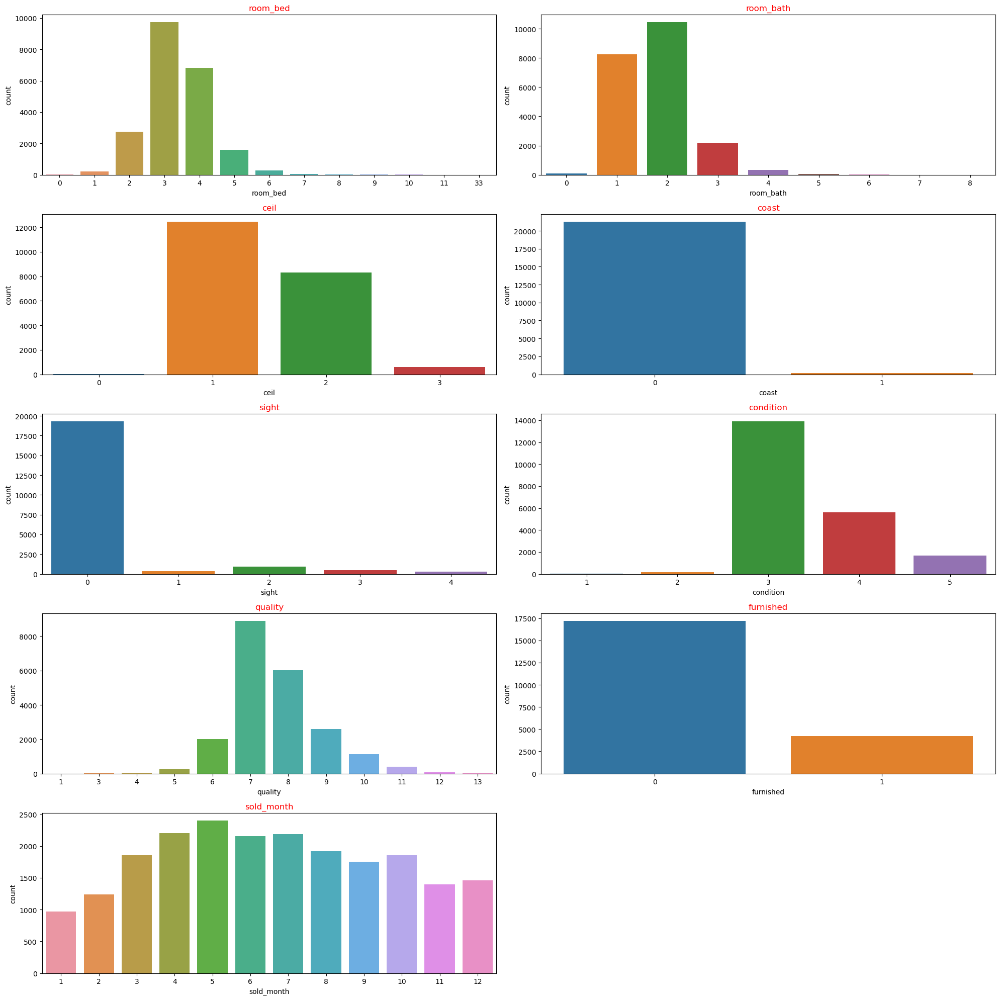

In [105]:
# count plot
fig=plt.figure(figsize=(20,20))
for i in range(0,len(category)):
   ax=fig.add_subplot(5,2,i+1)
   sns.countplot(df[category[i]])
   ax.set_title(category[i],color='Red')
plt.tight_layout()

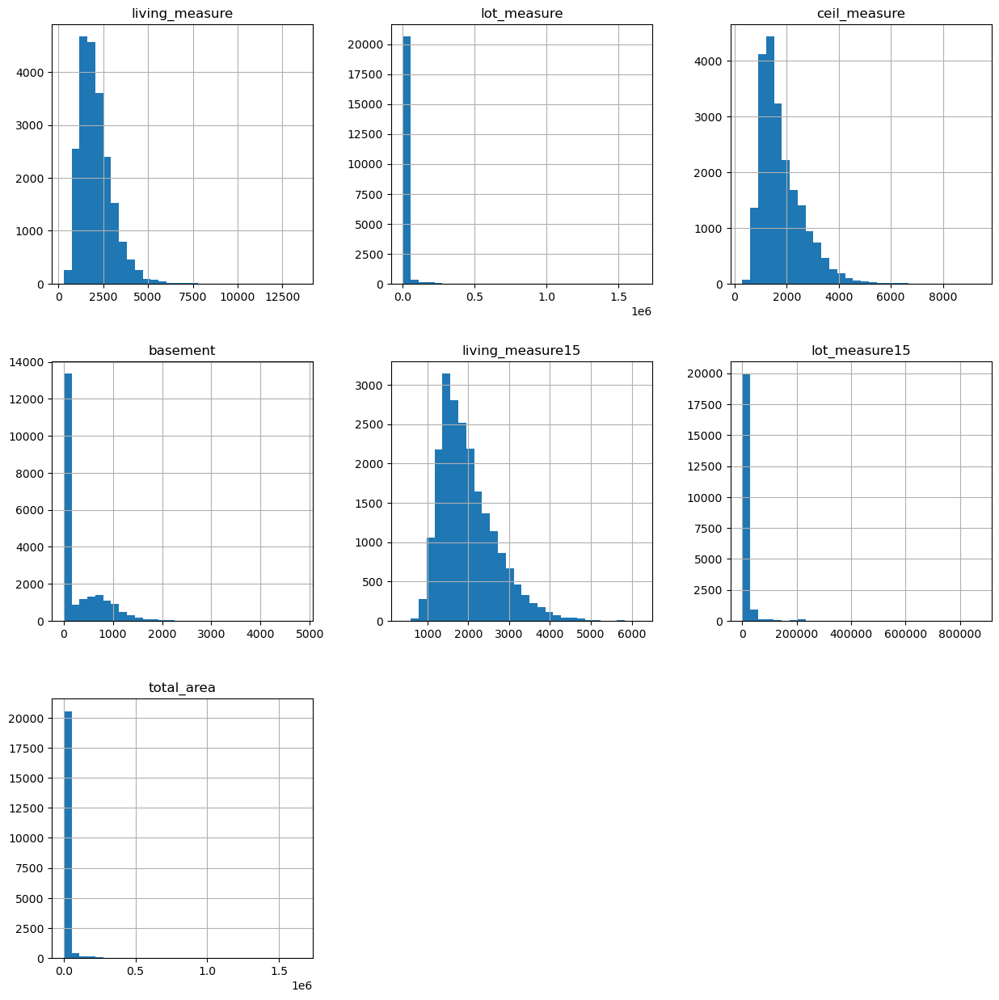

In [106]:
# histogram
df[continous_var].hist(bins=30, figsize=(15,15))
plt.show()


# changing the data of continuous variables in bell curve

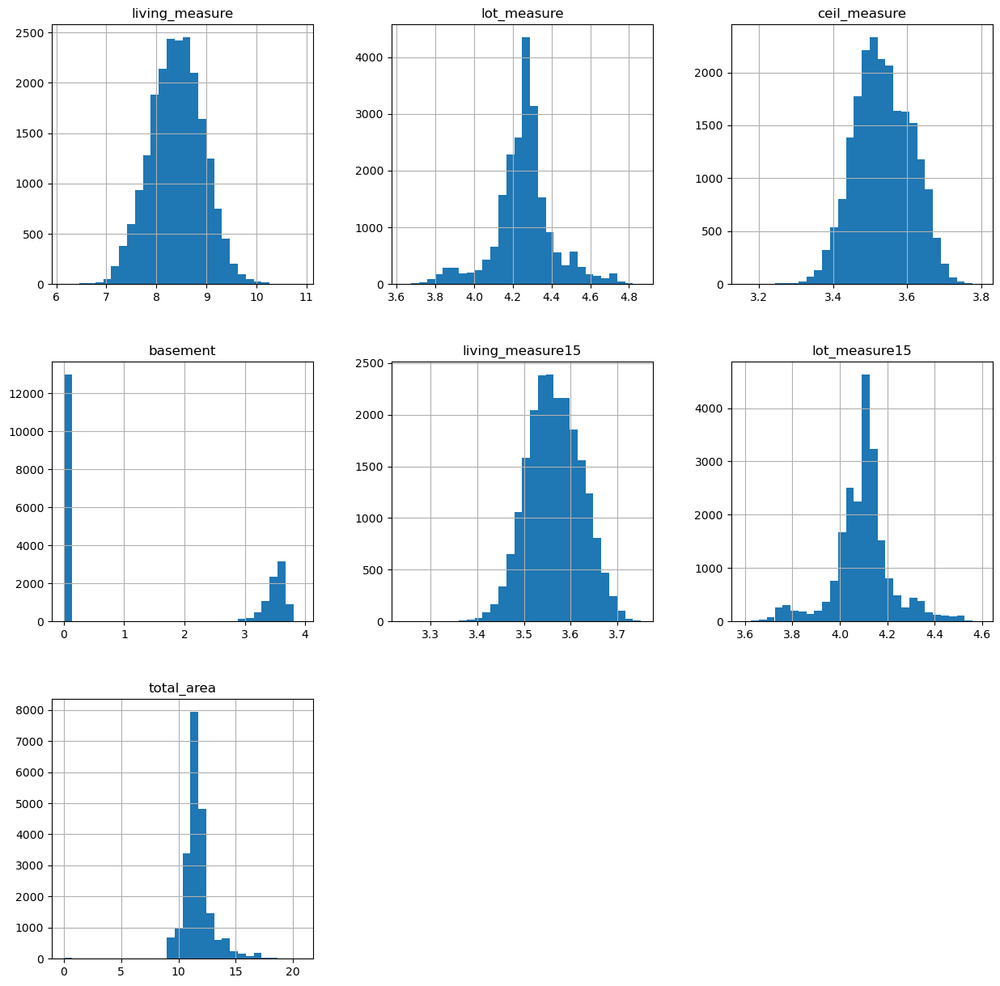

In [107]:
#bell curve data
import scipy.stats as stats
tmp = df.copy()

for var in continous_var:

    # transform the variable - yeo-johsnon
    tmp[var], param = stats.yeojohnson(df[var])

    
# plot the histograms of the transformed variables
tmp[continous_var].hist(bins=30, figsize=(15,15))
plt.show()

# Making box plot to check the outliers

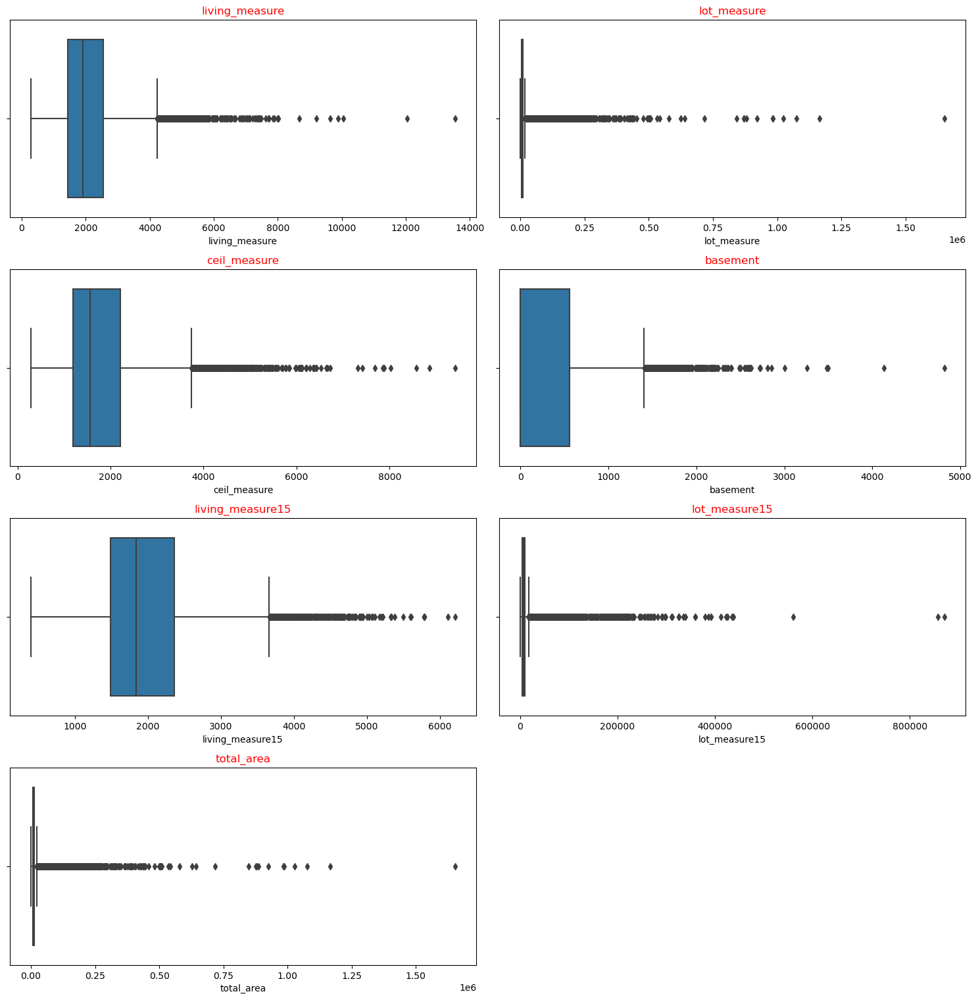

In [108]:
# box plot
fig=plt.figure(figsize=(15,30))
for i in range(0,len(continous_var)):
   ax=fig.add_subplot(8,2,i+1)
   sns.boxplot(df[continous_var[i]])
   ax.set_title(continous_var[i],color='Red')
plt.tight_layout()

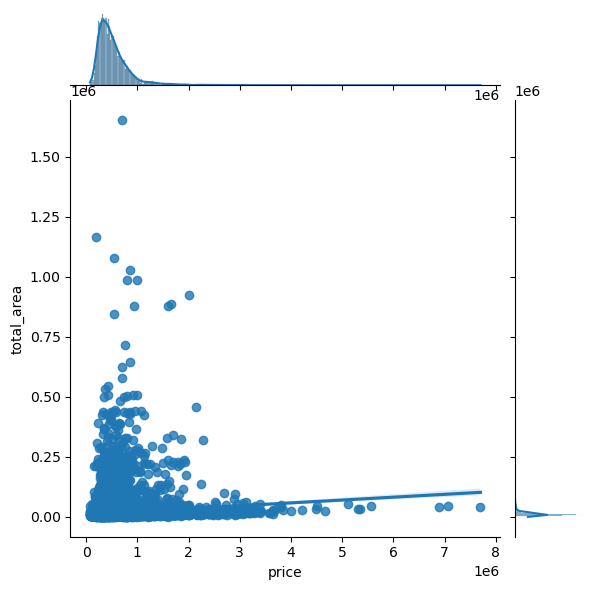

In [109]:
# jointplot 
# it shows the relationship between two columns
sns.jointplot(x='price',y='total_area',data=df,kind='reg')

# 2. Bivariate Analysis


Bivariate Analysis helps to understand how variables are related to each other and the relationship between dependent and independent variables present in the dataset.



For Numerical and continuous variables, Pair plots and Scatter plots are widely been used to do Bivariate Analysis.



In our example, a pair plot has been used to show the relationship between two Categorical variables.



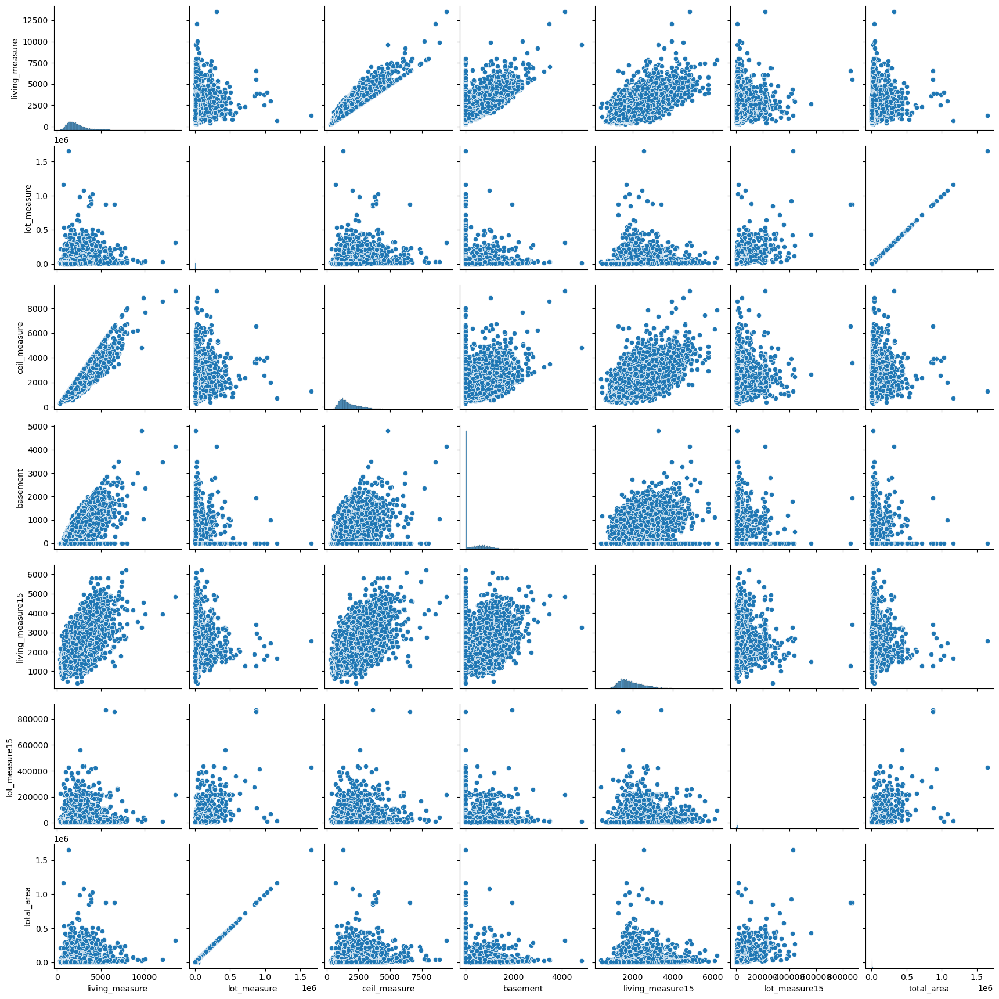

In [110]:
#Pair plot
sns.pairplot(df[continous_var])

<AxesSubplot:xlabel='total_area', ylabel='price'>

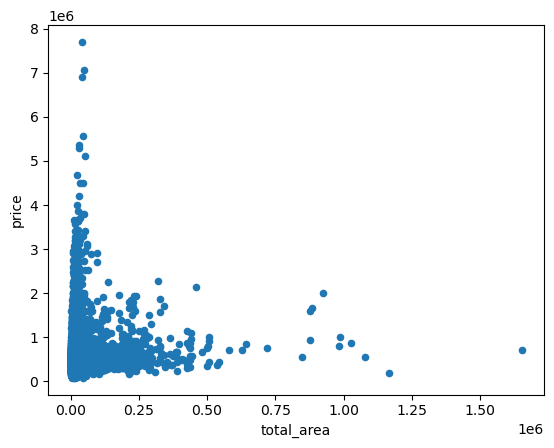

In [111]:
#Scatter plot
df.plot(x='total_area', y='price', kind='scatter') # we can enter column name for which we want to make scatter plot

# Multivariate Analysis

Multivariate analysis looks at more than two variables. Multivariate analysis is one of the most useful methods to determine relationships and analyze patterns for any dataset.

A heat map is widely been used for Multivariate Analysis



Heat Map gives the correlation between the variables, whether it has a positive or negative correlation.



In our example heat map shows the correlation between the variables.



<AxesSubplot:>

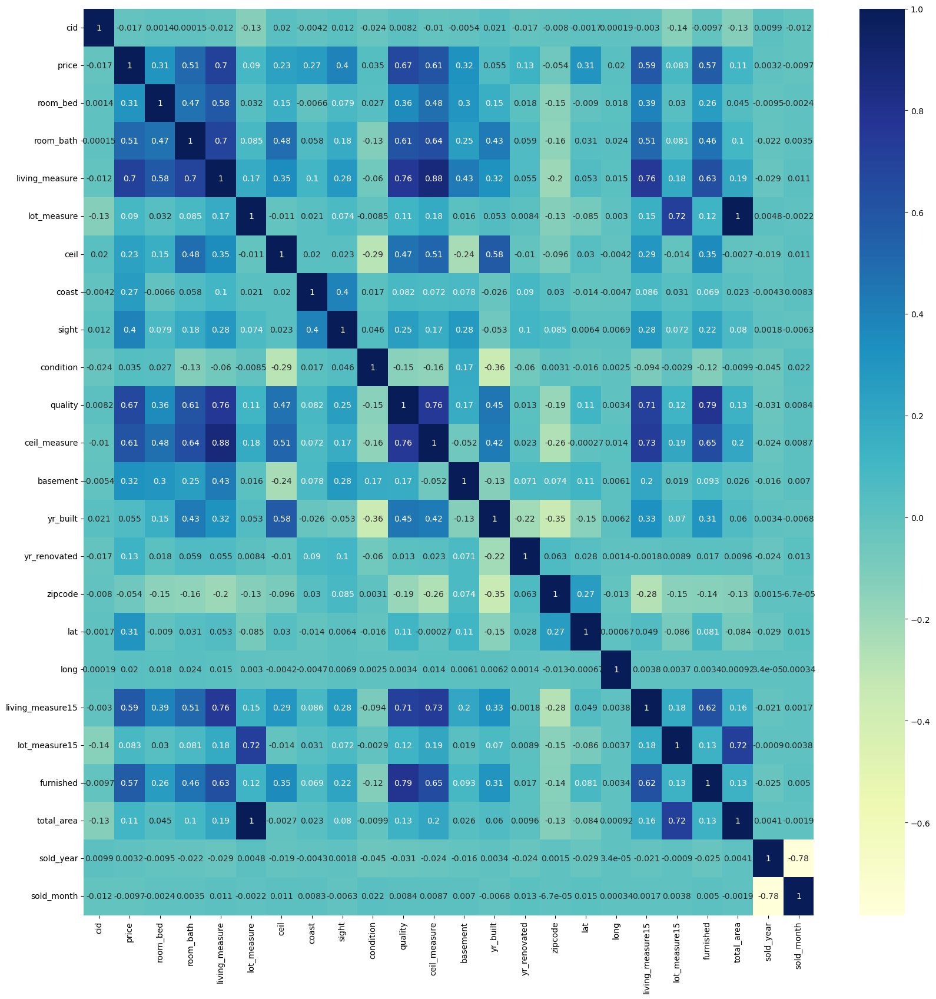

In [112]:
# Heatmap with correlation
plt.figure(figsize=(20,20))
sns.heatmap(df.corr(),cmap="YlGnBu",annot=True)

In [185]:
df.groupby(by=["room_bed"]).sum()


,cid,price,room_bath,living_measure,lot_measure,ceil,coast,sight,condition,quality,ceil_measure,basement,yr_built,yr_renovated,zipcode,lat,long,living_measure15,lot_measure15,furnished,total_area,sold_year,sold_month
room_bed,,,,,,,,,,,,,,,,,,,,,,,
0,60226897948,5332900,8,21622.0,108986.25,25,-21,4,37,87,21132.0,0.0,25790,0,1274867,617.6484,-1587.953,8164.0,109697.5,1,1.332205e+05,26186,93
1,819997812314,62828934,178,174498.0,1497437.50,216,-167,49,644,1202,162408.0,12050.0,382730,33758,19326276,9370.8504,-24084.413,10939.0,1483290.5,3,1.708971e+06,396819,1361
2,12641980783306,1097128882,3294,3387788.0,17564208.50,3477,-2990,492,9230,18775,3026220.0,361418.0,5340421,222612,267927646,129964.6223,-333453.090,107163.0,17163886.0,104,2.112194e+07,5501139,18017
3,44073674602886,4533024469,15552,17530322.0,82621759.50,13648,-11820,1835,33209,72643,15375398.0,2138737.0,19167721,738644,953401181,462246.7884,-1186449.648,-1036826.0,79504385.0,1182,1.002992e+08,19581271,63649
4,31716969433260,4330722668,13697,17226730.0,64912485.00,10623,-8803,1823,23192,55293,14785929.0,2360062.0,13461315,581509,667854143,323856.8241,-830760.288,-1474284.0,61258735.5,2239,8.177976e+07,13717478,44883
5,7143914799518,1246591576,3763,4648699.0,16115763.25,2395,-1743,652,5465,13107,3681433.0,959334.0,3129057,161800,155441153,75405.1938,-193322.193,-499074.0,15108392.0,592,2.066617e+07,3192703,10451
6,1181917752740,221374653,727,823068.0,2755392.75,408,-264,144,931,2163,639630.0,194990.0,526115,43862,26285292,12751.4583,-32516.186,-159247.0,2402238.5,72,3.564802e+06,539848,1682
7,153031722702,36155017,124,128850.0,412358.00,61,-42,19,131,321,106480.0,25090.0,74588,8005,3727261,1809.1429,-4645.147,-25856.0,338074.5,14,5.411480e+05,76540,252
8,60894204007,14366000,42,45530.0,115123.75,21,-18,3,46,105,31640.0,13260.0,25432,0,1275064,619.1901,-1467.205,-7650.0,92689.5,3,1.551788e+05,26184,109


In [1]:
#groupby
df.groupby('room_bath')['price'].mean().plot()
plt.ylabel('Median House Price')

NameError: name 'df' is not defined

In [115]:
#where
df["coast"] =df['sight'] - df['ceil'] 
df["coast"] = np.where(df["coast"]==df['sight'],0,df["coast"])

<AxesSubplot:xlabel='coast', ylabel='sight'>

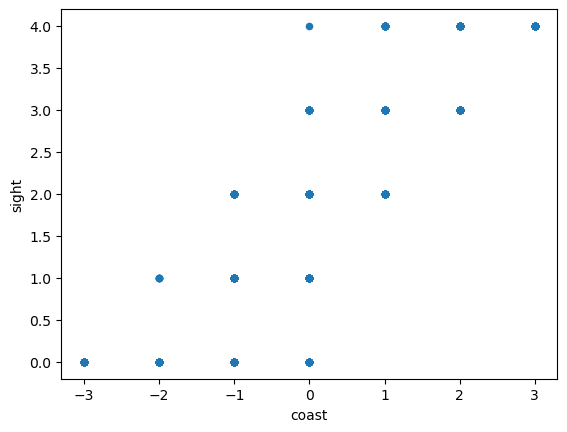

In [116]:
df.plot(x='coast',y='sight',kind='scatter')

In [117]:
#where
df["living_measure15"] =df['lot_measure15'] - df['lot_measure'] 
df["living_measure15"] = np.where(df["living_measure15"]==df['lot_measure15'],0,df["living_measure15"])

<AxesSubplot:xlabel='living_measure15', ylabel='lot_measure15'>

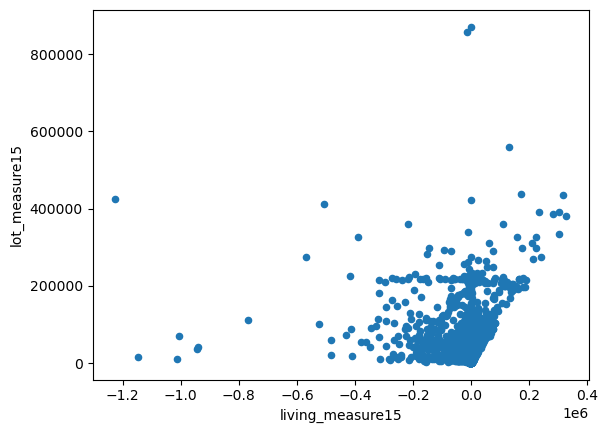

In [118]:
df.plot(x='living_measure15',y='lot_measure15',kind='scatter')

# Correlation matrix

Since we cannot use more than two variables as x-axis and y-axis in Scatter and Pair Plots, it is difficult to see the relation between three numerical variables in a single graph. In those cases, we’ll use the correlation matrix.



First, we created a matrix using basement, total_area, and price. After that, we are plotting the heatmap using the seaborn library of the matrix.



<AxesSubplot:>

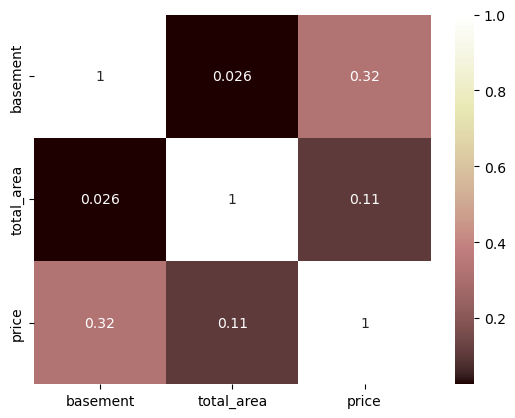

In [119]:
# Creating a matrix using basement, total_area, and price as rows and columns
df[['basement','total_area','price']].corr()
#plot the correlation matrix of basement, total_area, and price in data dataframe.
sns.heatmap(df[['basement','total_area','price']].corr(), annot=True, cmap = 'pink')

# Outliers

In [120]:
#Outliers
def remove_outlier(col):
    sorted(col)
    Q1,Q3=np.percentile(col,[25,75])
    IQR=Q3-Q1
    lower_range= Q1-(1.5 * IQR)
    upper_range= Q3+(1.5 * IQR)
    return lower_range, upper_range

In [121]:
for column in df[continous_var]:
    lr,ur=remove_outlier(df[column])
    df[column]=np.where(df[column]>ur,ur,df[column])
    df[column]=np.where(df[column]<lr,lr,df[column])

In [122]:
df.to_excel('clean_data_outliers.xlsx')

In [123]:
df.shape

(21387, 25)

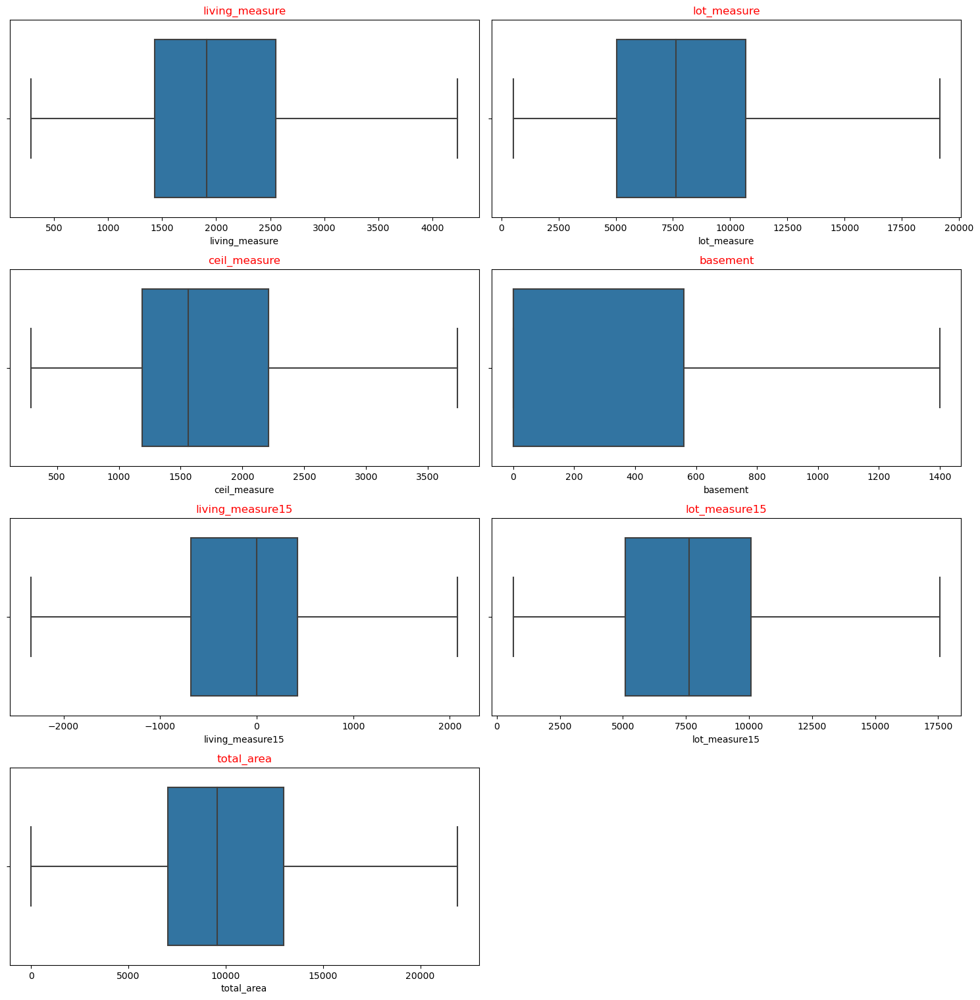

In [124]:
# boxplot
fig=plt.figure(figsize=(15,30))
for i in range(0,len(continous_var)):
   ax=fig.add_subplot(8,2,i+1)
   sns.boxplot(df[continous_var[i]])
   ax.set_title(continous_var[i],color='Red')
plt.tight_layout()

Now it does not show any outlier

# Train,Test,Split

for train,test,split we have to import a library

In [172]:
#df = df.drop("dayhours",axis=1)

 Independent and dependent features


In [173]:
x=df.drop("price",axis=1)
y=df["price"]

 Splitting dataset into training and testing data


# Feature scaling

In [131]:
from sklearn.model_selection import train_test_split
from imblearn.under_sampling import RandomUnderSampler

In [175]:
x_train, x_test, y_train, y_test = train_test_split(x,y,train_size=0.25,random_state=0)
#This splitting step is done to avoid overfitting.

Importing standard scaler


In [177]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
### fit vs fit_transform
x_train_scaled=scaler.fit_transform(x_train)
pd.DataFrame(x_train_scaled) 

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22
0,-0.974183,0.643441,0.338237,-0.526688,-0.924130,1.027509,-0.864564,-0.300858,-0.637259,-0.555268,-0.200104,-0.684290,1.432869,-0.204197,-0.672566,-1.457350,-0.014532,0.112489,-0.974906,-0.490570,-0.938940,-0.689618,1.749153
1,-1.229934,-0.366790,1.689668,1.453124,2.087891,1.027509,-0.864564,-0.300858,-0.637259,1.973234,1.966896,-0.684290,0.715790,-0.204197,-0.467206,0.768664,-0.003957,-0.392295,2.148173,2.038444,2.070890,1.450079,-1.471322
2,-0.589488,1.653671,-1.013194,-0.944119,-0.834807,-0.782397,0.228356,-0.300858,-0.637259,-0.555268,-0.657001,-0.684290,-1.537890,-0.204197,0.764954,0.595713,-0.071991,0.035084,-0.893185,-0.490570,-0.920790,-0.689618,-0.183132
3,-0.818925,-0.366790,-1.013194,-0.574395,-0.396165,-0.782397,0.228356,-0.300858,0.907768,-0.555268,-0.252320,-0.684290,-0.513490,-0.204197,-1.325984,0.285844,-0.025106,0.621390,-0.220944,-0.490570,-0.455937,-0.689618,-0.505180
4,-0.783148,-0.366790,0.338237,0.224686,-0.516393,1.027509,-0.864564,-0.300858,-0.637259,0.287566,0.622312,-0.684290,1.057256,-0.204197,-0.747242,-1.529413,-0.006751,-0.303360,-0.619395,-0.490570,-0.443529,-0.689618,1.749153
5,0.159703,-0.366790,-1.013194,-0.610175,0.421303,-0.782397,0.228356,-0.300858,2.452795,-1.398101,-1.296658,1.152489,-0.820810,-0.204197,-0.709904,0.099202,-0.042663,0.127312,0.587037,-0.490570,0.297828,-0.689618,-0.183132
6,-0.261656,0.643441,-1.013194,-0.729440,-0.001388,-0.782397,0.228356,-0.300858,-0.637259,-0.555268,-0.422025,-0.684290,-1.674476,-0.204197,1.866431,-0.436223,-0.043860,0.390820,0.171504,-0.490570,-0.113317,1.450079,-1.149275
7,1.038615,-0.366790,1.689668,-0.693661,-1.485790,1.027509,-0.864564,-0.300858,-0.637259,-0.555268,-0.761435,0.007484,1.262136,-0.204197,0.559594,-0.063659,-0.060818,0.133899,-1.619214,-0.490570,-1.486577,-0.689618,-0.183132
8,0.892414,0.643441,0.338237,0.308172,-0.605517,-0.782397,2.414195,2.386505,-0.637259,0.287566,-0.565622,1.653429,-0.650077,4.938459,0.746285,-0.356954,-0.048648,0.127312,-0.601850,-0.490570,-0.513349,-0.689618,-0.183132
9,1.734471,0.643441,0.338237,0.892575,-0.934498,1.027509,-0.864564,-0.300858,-0.637259,1.130400,1.353348,-0.684290,1.364576,-0.204197,0.466249,0.770825,-0.066006,0.292004,-0.936585,2.038444,-0.728182,-0.689618,1.105058


We use the Standardscaler from the sklearn library. We first imported Standardscaler and then did fit_transform on training data.

pd.DataFrame(X_train_scaled) will display the results in tabular form.

# Standardization of testing data


Standardization is another scaling technique where the values are centered around the mean with a unit standard deviation. This means that the mean of the attribute becomes zero and the resultant distribution has a unit standard deviation.


In [179]:
x_test_scaled=scaler.transform(x_test)
x_test_scaled  

array([[-0.06027669,  0.64344089,  0.33823694, ...,  0.92380518,
        -0.68961781,  0.13891536],
       [ 0.71446865,  0.64344089,  0.33823694, ..., -0.38370923,
         1.45007855, -0.82722711],
       [-0.44756288, -0.36678965, -1.01319405, ...,  0.09966366,
        -0.68961781, -0.18313213],
       ...,
       [-0.61935385,  0.64344089,  0.33823694, ...,  0.26541797,
        -0.68961781,  1.10505783],
       [ 0.60644302,  0.64344089,  0.33823694, ...,  0.0652164 ,
        -0.68961781,  0.46096285],
       [ 0.95475348,  1.65367143,  0.33823694, ...,  0.3385721 ,
        -0.68961781,  0.78301034]])

# Normalization

Normalization is a scaling technique in which values are shifted and rescaled so that they end up ranging between 0 and 1. It is also known as Min-Max scaling.

In [140]:
# data normalization with sklearn
from sklearn.preprocessing import MinMaxScaler

In [180]:
min_max=MinMaxScaler()
df_minmax=pd.DataFrame(min_max.fit_transform(x_train))
df_minmax.head() 

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22
0,0.178786,0.121212,0.333333,0.319481,0.187230,0.666667,0.166667,0.0,0.50,0.4,0.366071,0.0,0.982609,0.0,0.207071,0.304551,0.003575,0.524909,0.200041,0.0,0.258377,0.0,1.000000
1,0.104040,0.090909,0.500000,0.750649,1.000000,0.666667,0.166667,0.0,0.50,0.7,0.860119,0.0,0.800000,0.0,0.262626,0.819470,0.004008,0.386096,1.000000,1.0,1.000000,1.0,0.090909
2,0.291217,0.151515,0.166667,0.228571,0.211333,0.333333,0.333333,0.0,0.50,0.4,0.261905,0.0,0.226087,0.0,0.595960,0.779463,0.001224,0.503623,0.220974,0.0,0.262849,0.0,0.454545
3,0.224162,0.090909,0.166667,0.309091,0.329697,0.333333,0.333333,0.0,0.75,0.4,0.354167,0.0,0.486957,0.0,0.030303,0.707785,0.003142,0.664855,0.393164,0.0,0.377389,0.0,0.363636
4,0.234618,0.090909,0.333333,0.483117,0.297255,0.666667,0.166667,0.0,0.50,0.5,0.553571,0.0,0.886957,0.0,0.186869,0.287881,0.003893,0.410553,0.291104,0.0,0.380446,0.0,1.000000


# Implementing a Robust scaler on training data


In [181]:
from sklearn.preprocessing import RobustScaler
scaler=RobustScaler()
df_robust_scaler=pd.DataFrame(scaler.fit_transform(x_train))
df_robust_scaler.head()
 


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22
0,-0.411640,1.0,0.0,-0.258929,-0.650205,1.0,-1.0,0.0,0.0,0.0,0.059406,0.0,0.844444,0.0,-0.270588,-1.067807,0.724138,-0.016183,-0.724444,0.0,-0.671426,0.0,1.2
1,-0.554122,0.0,1.0,1.223214,2.102733,1.0,-1.0,0.0,0.0,3.0,1.702970,0.0,0.377778,0.0,-0.141176,0.463865,0.985222,-0.567318,2.008586,1.0,2.124333,1.0,-0.8
2,-0.197322,2.0,-1.0,-0.571429,-0.568565,0.0,0.0,0.0,0.0,0.0,-0.287129,0.0,-1.088889,0.0,0.635294,0.344862,-0.694581,-0.100697,-0.652929,0.0,-0.654567,0.0,0.0
3,-0.325144,0.0,-1.0,-0.294643,-0.167654,0.0,0.0,0.0,1.0,0.0,0.019802,0.0,-0.422222,0.0,-0.682353,0.131647,0.463054,0.539447,-0.064646,0.0,-0.222777,0.0,-0.2
4,-0.305213,0.0,0.0,0.303571,-0.277540,1.0,-1.0,0.0,0.0,1.0,0.683168,0.0,0.600000,0.0,-0.317647,-1.117392,0.916256,-0.470218,-0.413333,0.0,-0.211251,0.0,1.2


First imported Robust scaler, and then performed transformation on training data 



# Implementing a Robust scaler for testing data


In [183]:
pd.DataFrame(scaler.transform(x_test)) 

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22
0,9.750716e-02,1.0,0.0,0.955357,0.934852,0.0,1.0,1.0,1.0,0.0,0.574257,1.473684,-1.266667,1986.0,-0.717647,0.187678,0.073892,1.870083,1.551515,0.0,1.058834,0.0,0.2
1,5.291265e-01,1.0,0.0,0.892857,-0.338952,0.0,0.0,0.0,1.0,1.0,0.108911,2.175439,-0.355556,0.0,0.623529,-0.127185,-0.216749,0.303889,-0.307475,0.0,-0.155686,1.0,-0.4
2,-1.182543e-01,0.0,-1.0,-0.473214,0.415490,0.0,0.0,0.0,1.0,0.0,-0.178218,0.000000,0.177778,0.0,-0.729412,-1.577538,-0.413793,-0.269724,0.400000,0.0,0.293308,0.0,0.0
3,-1.319876e-01,1.0,0.0,-0.196429,-0.809294,1.0,-1.0,0.0,0.0,1.0,0.128713,0.000000,0.600000,0.0,0.317647,-1.238874,0.206897,0.369521,-0.814141,0.0,-0.809565,0.0,0.2
4,-3.662083e-01,1.0,0.0,0.125000,-0.289021,1.0,-1.0,0.0,0.0,0.0,0.485149,0.000000,0.333333,0.0,0.588235,0.592785,-0.467980,-0.043156,-0.330101,0.0,-0.256494,0.0,0.0
5,-6.515562e-01,1.0,-1.0,-0.517857,0.013485,0.0,0.0,0.0,0.0,0.0,-0.227723,0.000000,-1.044444,1972.0,0.976471,-0.723689,-0.477833,0.695887,0.171313,0.0,-0.094788,1.0,-0.4
6,-5.235307e-01,0.0,0.0,-0.196429,-0.498223,1.0,-1.0,0.0,0.0,0.0,-0.366337,0.877193,-0.777778,0.0,0.623529,-0.109334,-0.285714,0.012587,-0.549495,0.0,-0.515913,1.0,-0.4
7,-5.519850e-01,0.0,0.0,0.071429,2.102733,1.0,-1.0,0.0,0.0,1.0,0.425743,0.000000,0.422222,0.0,-0.635294,0.831288,0.157635,-2.100247,1.040202,0.0,2.124333,0.0,0.4
8,8.188228e-01,1.0,-1.0,0.250000,-0.647654,0.0,0.0,0.0,0.0,-1.0,-0.277228,1.596491,-1.422222,0.0,0.623529,-0.133631,-0.241379,-2.100247,-1.268081,0.0,-0.570962,1.0,-0.4
9,4.327031e-01,1.0,0.0,1.107143,1.563554,0.0,1.0,1.0,0.0,2.0,1.009901,1.000000,0.288889,0.0,1.188235,-0.690963,-0.561576,-2.100247,1.127273,1.0,1.681576,0.0,1.0


It is not necessary to perform feature scaling for every algorithm. This concept needs to be applied for some particular algorithm only. But for those algorithms it is recommended to apply it else it will affect the output be it accuracy be it precision be it RMSE score.